<a href="https://colab.research.google.com/github/fedhere/covid19Vizs/blob/master/code/coronavirus.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**a quick, possibly (certainly) buggy analysis of the cornavirus data on Kaggle https://www.kaggle.com/sudalairajkumar/novel-corona-virus-2019-dataset**

Visualizing the number of deaths, and the presence of the virus by country

TODO: 
* export the bokeh interactive plot to the web
* normalize by population
* review and kill bugs
* review and simplify syntax
* review and comment for posterity

In [0]:
import pandas as pd
import pylab as pl
import geopandas as gpd
import shapely

%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [0]:
from bokeh.io import output_file, show, output_notebook, export_png
from bokeh.models import ColumnDataSource, GeoJSONDataSource, LinearColorMapper, ColorBar
from bokeh.plotting import figure
from bokeh.palettes import brewer

#!pip install panel
import panel as pn
import panel.widgets as pnw
pn.extension()
#output_notebook()
output_file("test.html")


In [0]:
deaths = pd.read_csv("time_series_19-covid-Deaths.csv")

In [0]:
deaths.describe()

,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,...,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20
count,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,...,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000
mean,31.837666,5.588510,0.085427,0.090452,0.130653,0.211055,0.281407,0.412060,0.658291,0.668342,...,13.919598,14.140704,14.432161,14.778894,15.055276,15.502513,15.879397,16.351759,16.824121,17.386935
std,20.587764,88.895261,1.205098,1.206824,1.703536,2.836572,3.687435,5.388077,8.860525,8.860909,...,185.335550,187.179302,190.087870,193.284323,195.704766,198.707335,201.021948,203.650639,205.985079,208.262669
min,-41.454500,-123.869500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,27.612200,-79.280650,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,36.342700,12.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,42.992450,101.243500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,64.963100,174.886000,17.000000,17.000000,24.000000,40.000000,52.000000,76.000000,125.000000,125.000000,...,2615.000000,2641.000000,2682.000000,2727.000000,2761.000000,2803.000000,2835.000000,2871.000000,2902.000000,2931.000000


In [0]:
deaths.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20
0,Anhui,Mainland China,31.8257,117.2264,0,0,0,0,0,0,...,6,6,6,6,6,6,6,6,6,6
1,Beijing,Mainland China,40.1824,116.4142,0,0,0,0,0,1,...,4,5,7,8,8,8,8,8,8,8
2,Chongqing,Mainland China,30.0572,107.8740,0,0,0,0,0,0,...,6,6,6,6,6,6,6,6,6,6
3,Fujian,Mainland China,26.0789,117.9874,0,0,0,0,0,0,...,1,1,1,1,1,1,1,1,1,1
4,Gansu,Mainland China,36.0611,103.8343,0,0,0,0,0,0,...,2,2,2,2,2,2,2,2,2,2


In [0]:
deaths = gpd.GeoDataFrame(deaths)

In [0]:
# combine lat and lon to one column
deaths['lonlat'] = list(zip(deaths.Long, deaths.Lat))
# Create Point Geometry for based on lonlat column
deaths['geometry'] = deaths[['lonlat']].applymap(lambda x:shapely.geometry.Point(x))
deaths.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,lonlat,geometry
0,Anhui,Mainland China,31.8257,117.2264,0,0,0,0,0,0,...,6,6,6,6,6,6,6,6,"(117.2264, 31.8257)",POINT (117.2264 31.8257)
1,Beijing,Mainland China,40.1824,116.4142,0,0,0,0,0,1,...,7,8,8,8,8,8,8,8,"(116.4142, 40.1824)",POINT (116.4142 40.1824)
2,Chongqing,Mainland China,30.0572,107.8740,0,0,0,0,0,0,...,6,6,6,6,6,6,6,6,"(107.874, 30.0572)",POINT (107.874 30.0572)
3,Fujian,Mainland China,26.0789,117.9874,0,0,0,0,0,0,...,1,1,1,1,1,1,1,1,"(117.9874, 26.0789)",POINT (117.9874 26.0789)
4,Gansu,Mainland China,36.0611,103.8343,0,0,0,0,0,0,...,2,2,2,2,2,2,2,2,"(103.8343, 36.0611)",POINT (103.8343 36.0611)


In [0]:
deaths.tail()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,lonlat,geometry
194,"Ramsey County, MN",US,44.9964,-93.0616,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,"(-93.0616, 44.9964)",POINT (-93.0616 44.9964)
195,"Washoe County, NV",US,40.5608,-119.6035,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,"(-119.6035, 40.5608)",POINT (-119.6035 40.5608)
196,"Wayne County, PA",US,41.6739,-75.2479,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,"(-75.2479, 41.6739)",POINT (-75.2479 41.6739)
197,"Yolo County, CA",US,38.7646,-121.9018,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,"(-121.9018, 38.7646)",POINT (-121.9018 38.7646)
198,NaN,Vatican City,41.9029,12.4534,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,"(12.4534, 41.9029)",POINT (12.4534 41.9029)


In [0]:
for i in range(len(deaths)):
    if not isinstance(deaths['Province/State'][i], float):
        deaths['Province/State'][i] + deaths["Country/Region"][i] 
    else :
        deaths["Country/Region"] 
                      

In [0]:
deaths['location'] = [deaths['Province/State'][i] + deaths["Country/Region"][i] 
                      if not isinstance(deaths['Province/State'][i], float) else deaths["Country/Region"][i] 
                      for i in range(len(deaths))]
deaths.index = deaths["location"]
deaths[deaths.columns[4:-28]].head()

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20
location,,,,,,,,,,,,,,,,,,,,
AnhuiMainland China,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,3
BeijingMainland China,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,2,2,2
ChongqingMainland China,0,0,0,0,0,0,0,0,0,0,1,2,2,2,2,2,2,2,2,2
FujianMainland China,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GansuMainland China,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,2


In [0]:
deaths["totaldeaths"] = deaths[deaths.columns[4:-3]].sum(axis=1)

In [0]:
deaths['logtotaldeaths'] = np.log10(deaths['totaldeaths'])

/Users/fbb/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log10
  """Entry point for launching an IPython kernel.


(-198.00000009536743,
 198.00000200271606,
 -98.67851343154908,
 92.24878206253054)

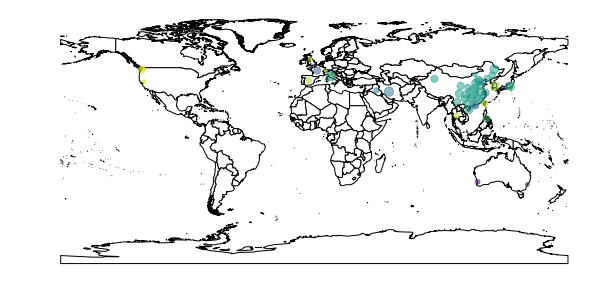

In [0]:
world = gpd.GeoDataFrame.from_file("../../TM_WORLD_BORDERS_SIMPL-0.3.shp")
ax = world.plot(figsize=(10,10), edgecolor="k", facecolor="w")
deaths.plot(ax=ax, column="Country/Region", 
            markersize=deaths.logtotaldeaths * 30, alpha=0.5, cmap="viridis")
ax.axis("off")

In [0]:
deaths["firstoccurrence"] = np.zeros(len(deaths)) * np.nan
for i in deaths.index:
    done = False
    for j in range(4, len(deaths.columns)-6):
        #print(i,j, deaths.iloc[i,j], done)
        if done:
            break
        #print(i, j, deaths.iloc[i,j])
        if (deaths.loc[i][j]) > 0: 
            #print("\t", i,j, deaths.iloc[i,j], done)
            deaths.loc[i, "firstoccurrence"] = deaths.columns[j]
            done = True
            


In [0]:
deaths["Country/Region"].replace("Mainland China", "China", inplace=True)
deaths["Country/Region"].replace("UK", "United Kingdom", inplace=True)
deaths["Country/Region"].replace("US", "United States", inplace=True)

In [0]:
deaths.loc[i][j], i, j, deaths.columns[j]

(0, 'Vatican City', 48, '3/6/20')

In [0]:
deaths["firstoccurrence"] = pd.to_datetime(deaths.firstoccurrence)


/Users/fbb/anaconda3/lib/python3.7/site-packages/matplotlib/collections.py:874: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor


(-198.00000009536743,
 198.00000200271606,
 -98.67851343154908,
 92.24878206253054)

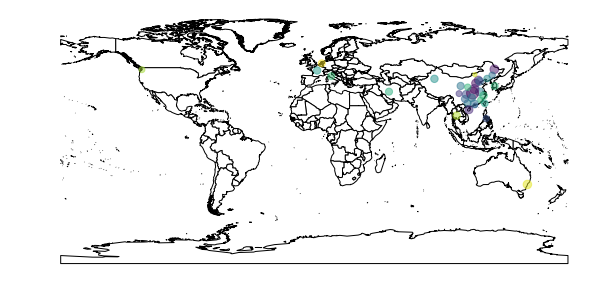

In [0]:
world = gpd.GeoDataFrame.from_file("../../TM_WORLD_BORDERS_SIMPL-0.3.shp")
ax = world.plot(figsize=(10,10), edgecolor="k", facecolor="w")
deaths[~pd.isnull(deaths.firstoccurrence)].plot(ax=ax, column="firstoccurrence", 
            markersize=deaths.logtotaldeaths * 30, alpha=0.5, cmap="viridis")
ax.axis("off")
#pl.colorbar()

In [0]:
maxday = pd.Timedelta(pd.to_datetime(deaths.columns[-7]) - pd.to_datetime("01/01/2020"))

In [0]:
for d in deaths.columns[4:-6]:
    deaths[pd.to_datetime(d).strftime('%Y-%m-%d')] = np.log10(deaths[d] + 1)
deaths

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,2020-02-26,2020-02-27,2020-02-28,2020-02-29,2020-03-01,2020-03-02,2020-03-03,2020-03-04,2020-03-05,2020-03-06
location,,,,,,,,,,,,,,,,,,,,,
AnhuiMainland China,Anhui,China,31.82570,117.2264,0,0,0,0,0,0,...,0.845098,0.845098,0.845098,0.845098,0.845098,0.845098,0.845098,0.845098,0.845098,0.845098
BeijingMainland China,Beijing,China,40.18240,116.4142,0,0,0,0,0,1,...,0.698970,0.778151,0.903090,0.954243,0.954243,0.954243,0.954243,0.954243,0.954243,0.954243
ChongqingMainland China,Chongqing,China,30.05720,107.8740,0,0,0,0,0,0,...,0.845098,0.845098,0.845098,0.845098,0.845098,0.845098,0.845098,0.845098,0.845098,0.845098
FujianMainland China,Fujian,China,26.07890,117.9874,0,0,0,0,0,0,...,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030
GansuMainland China,Gansu,China,36.06110,103.8343,0,0,0,0,0,0,...,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121
GuangdongMainland China,Guangdong,China,23.34170,113.4244,0,0,0,0,0,0,...,0.903090,0.903090,0.903090,0.903090,0.903090,0.903090,0.903090,0.903090,0.903090,0.903090
GuangxiMainland China,Guangxi,China,23.82980,108.7881,0,0,0,0,0,0,...,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121
GuizhouMainland China,Guizhou,China,26.81540,106.8748,0,0,0,0,0,0,...,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121,0.477121
HainanMainland China,Hainan,China,19.19590,109.7453,0,0,0,0,0,1,...,0.778151,0.778151,0.778151,0.778151,0.778151,0.778151,0.778151,0.778151,0.845098,0.845098


for d in deaths.columns[4:-6]:
    deaths[.rename({d:]pd.to_datetime(d).strftime('%Y-%m-%d')}, axis=1, inplace=True)
deaths

In [0]:
def get_geodatasource(gdf):    
    """Get getjsondatasource from geopandas object"""
    #print("now", gdf)
    json_data = json.dumps(json.loads(gdf.to_json()))
    json_data
    return GeoJSONDataSource(geojson = json_data)


def bokeh_plot_map(gdf, column=None, title=''):
    """Plot bokeh map from GeoJSONDataSource """

    geosource = get_geodatasource(gdf)
    palette = brewer['OrRd'][9]
    palette = palette[::-1]
    vals = gdf[column]
    #Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
    color_mapper = LinearColorMapper(palette = palette, low = 0, high = 2.5)
    
    color_bar = ColorBar(color_mapper=color_mapper, width=350, height=20,
                         location=(0,0), orientation='horizontal',
                        title="log number of deaths")

    tools = 'wheel_zoom,pan,reset'
    p = figure(title = title, plot_height=800 , plot_width=1700, toolbar_location='right', tools=tools)
    p.xgrid.grid_line_color = None
    p.ygrid.grid_line_color = None
    #Add patch renderer to figure
    p.patches('xs','ys', source=geosource, fill_alpha=1, line_width=0.5, line_color='black',  
              fill_color={'field' :column , 'transform': color_mapper})
    #Specify figure layout.
    p.add_layout(color_bar, 'below')
    return p




In [0]:

def get_dataset(key="firstoccurrence", day=0, df=deaths):
    if  day < 22:
        tmp = world[["NAME", "geometry"]].copy()
        newt = (pd.to_datetime("1/1/2020") + pd.Timedelta(day, "D")).strftime('%Y-%m-%d')
        tmp[newt] = np.zeros(len(tmp))
        return tmp, newt 
    elif day > int(maxday.days):
            #not newt in worlddeaths.columns:
            day = int(maxday.days)
    newt = (pd.to_datetime("1/1/2020") + pd.Timedelta(day, "D")).strftime('%Y-%m-%d')
    if newt not in df.columns:
        newt = (pd.to_datetime("2/29/2020") + pd.Timedelta(day, "D")).strftime('%Y-%m-%d')
    #[(tmp["NAME"] =="China") |
    # (tmp["NAME"] == "Italy")], newt
    #print(deaths[["Country/Region", newt]])
    worlddeaths = world[["NAME", "geometry"]].merge(
        df[["Country/Region", newt]], 
        left_on="NAME", right_on="Country/Region", how="left")
    #worlddeaths  = worlddeaths[(worlddeaths["NAME"] =="China") |
    # (worlddeaths["NAME"] == "Italy")]
    worlddeaths = gpd.GeoDataFrame(worlddeaths.groupby("NAME").sum().reset_index(
    ).merge(worlddeaths[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
            on="NAME", how="left"))
    worlddeaths[newt] = worlddeaths[newt].fillna(0)
    #print(worlddeaths)
    return worlddeaths, newt


In [0]:
data, key = get_dataset(day=24)
data = gpd.GeoDataFrame(data.groupby("NAME").sum().reset_index(
    ).merge(data[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
            on="NAME", how="left"))#.plot()


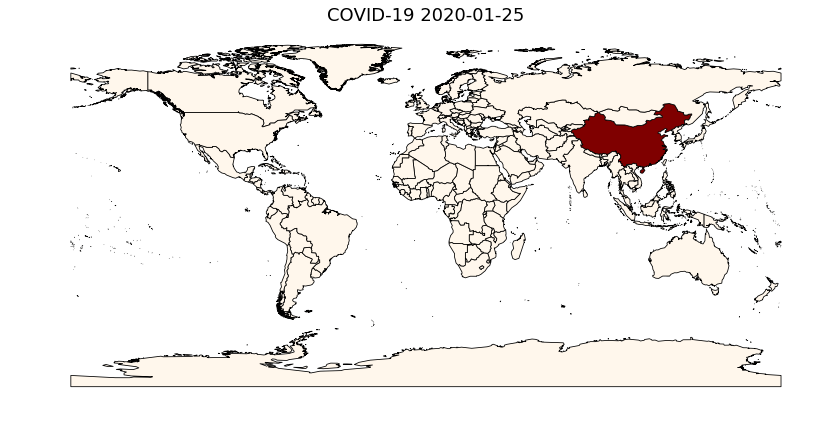

In [0]:

fig, ax = plt.subplots(1, figsize=(14, 8))
data.plot(column=key, 
          clim=(0,100), cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black')
ax.axis('off')
ax.set_title('COVID-19 %s'%key, fontsize=18);

In [0]:


def map_dash():
    """Map dashboard"""

    from bokeh.models.widgets import DataTable
    map_pane = pn.pane.Bokeh(width=400, height=300)
    #data_select = pnw.Select(name='dataset',options=list(
    #    datatmp))
    day_slider = pnw.IntSlider(start=22, end=90, value=25)
    
    def update_map(event):
        #data,key = get_dataset(day=0)
        #data = gpd.GeoDataFrame(data.groupby("NAME").sum().reset_index(
        #    ).merge(data[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
        #        on="NAME", how="left"))#.plot()

        gdf,key = get_dataset(day=day_slider.value)        
        #print("here", gdf, key)
        map_pane.object = bokeh_plot_map(gdf, key)        
        return
    day_slider.param.watch(update_map,'value')
    day_slider.param.trigger('value')
    #data_select.param.watch(update_map,'value')
    app = pn.Column(pn.Row("days since 01/01/2020",#data_select, 
        day_slider),map_pane)
    return app

app = map_dash()
app

Column
    [0] Row
        [0] Markdown(str)
        [1] IntSlider(end=90, start=22, value=25)
    [1] Bokeh(Figure, height=300, sizing_mode='fixed', width=400)

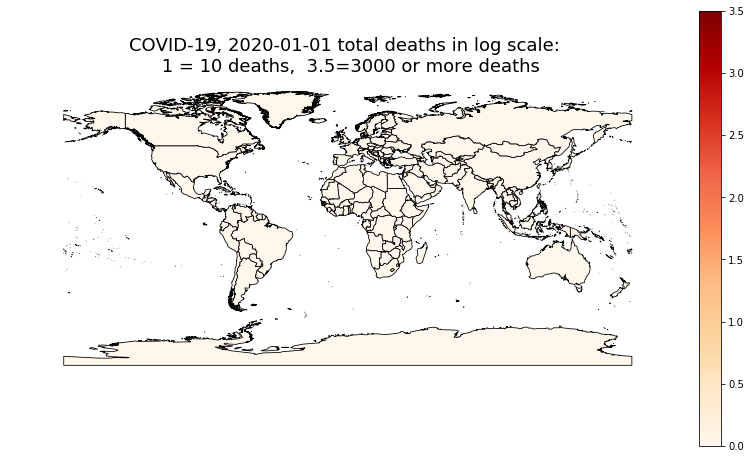

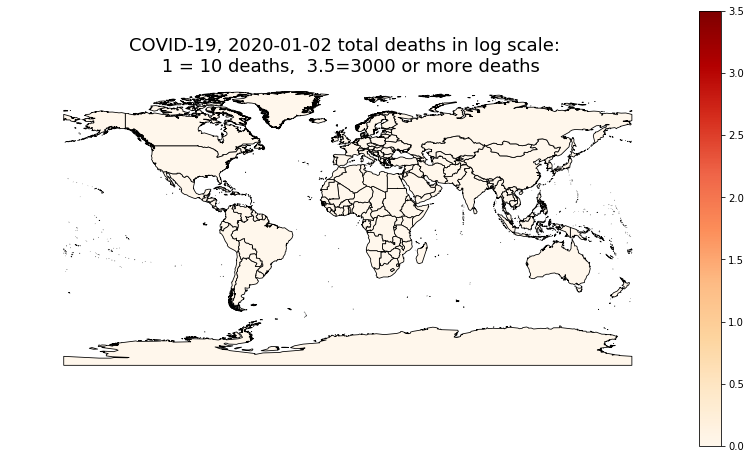

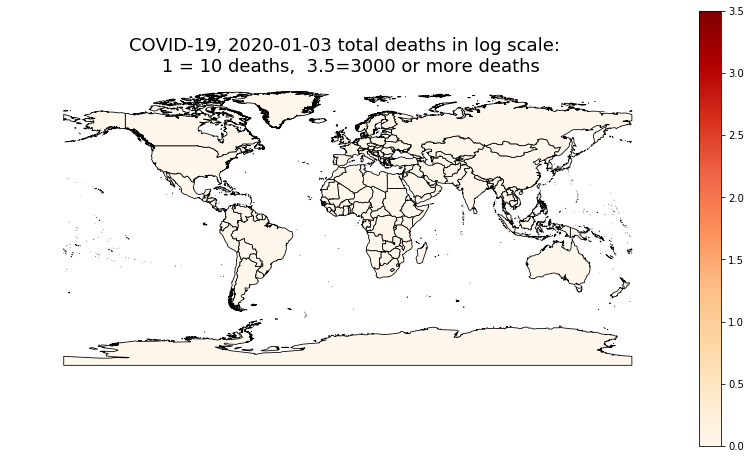

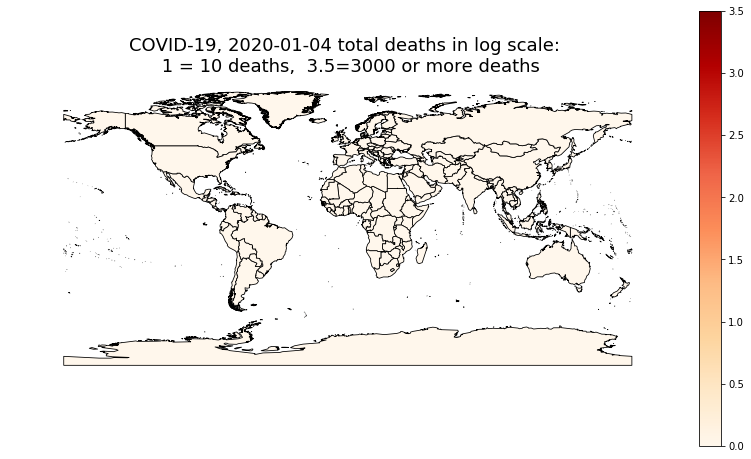

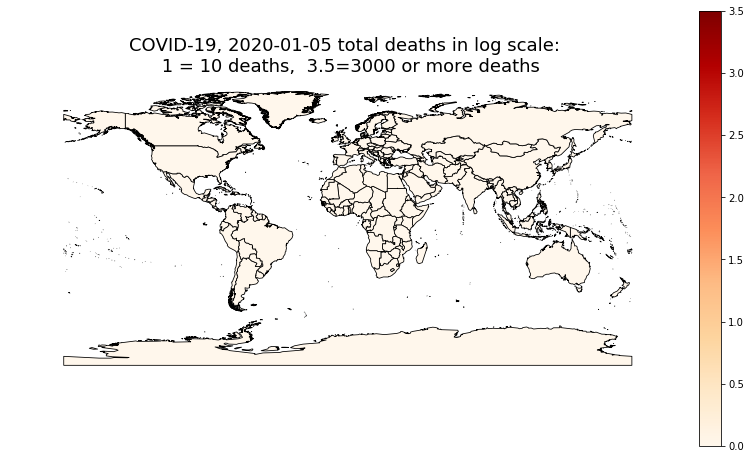

...

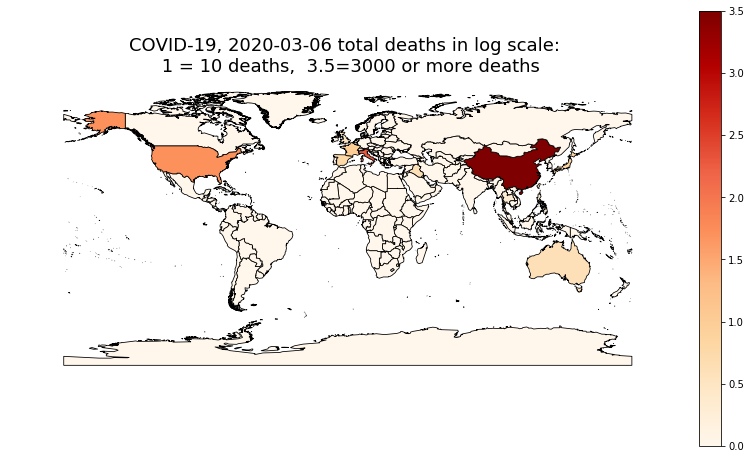

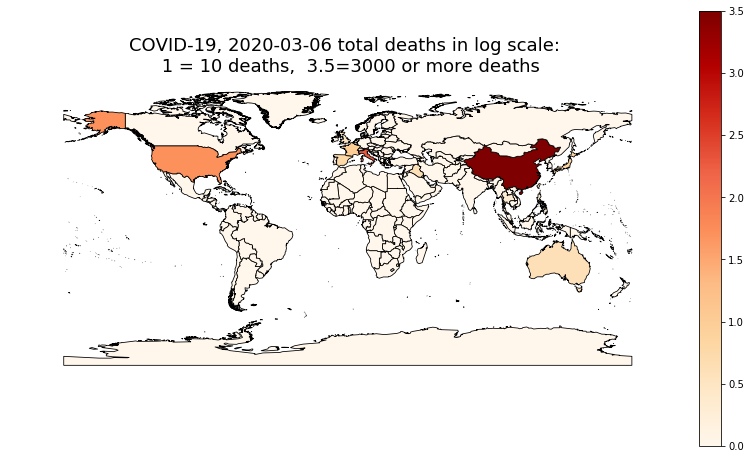

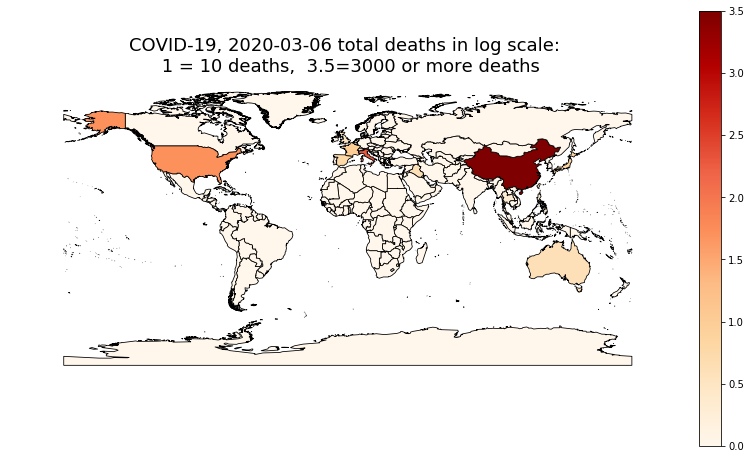

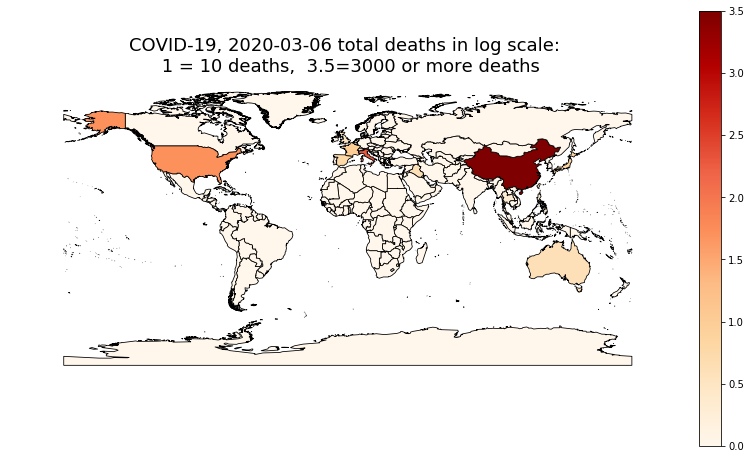

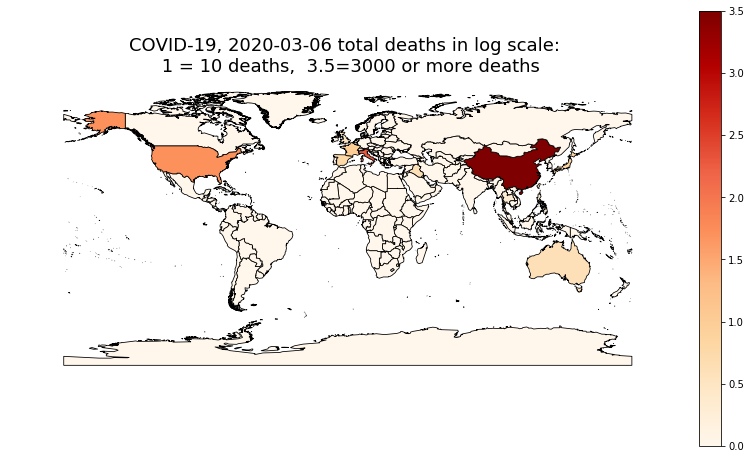

In [0]:
for day in range(0,90):
    data,key = get_dataset(day=day)
    fig, ax = plt.subplots(1, figsize=(14, 8))
    data.plot(column=key, cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black', 
              legend=True, vmin=0, vmax=3.5)
    
    ax.axis('off')
    ax.set_title('COVID-19, %s total deaths in log scale: \n 1 = 10 deaths,  3.5=3000 or more deaths'%key, fontsize=18);
    pl.savefig("COVID-19-%s.png"%key)

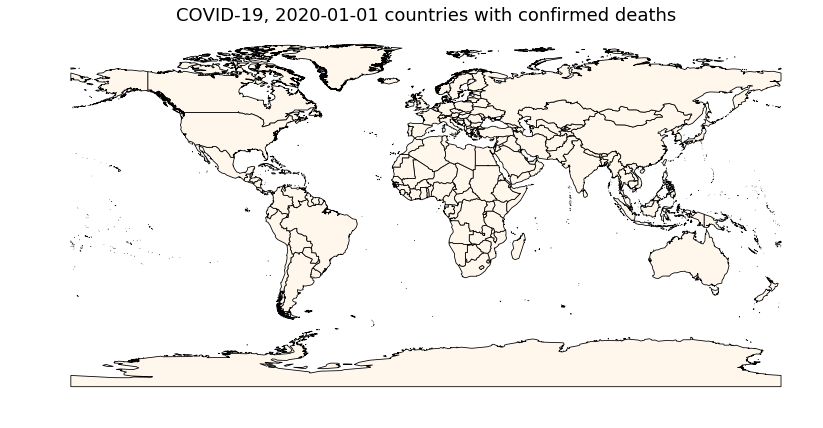

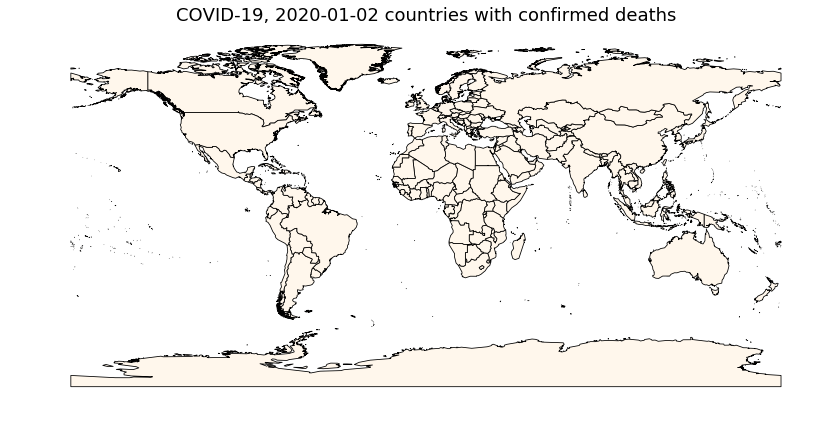

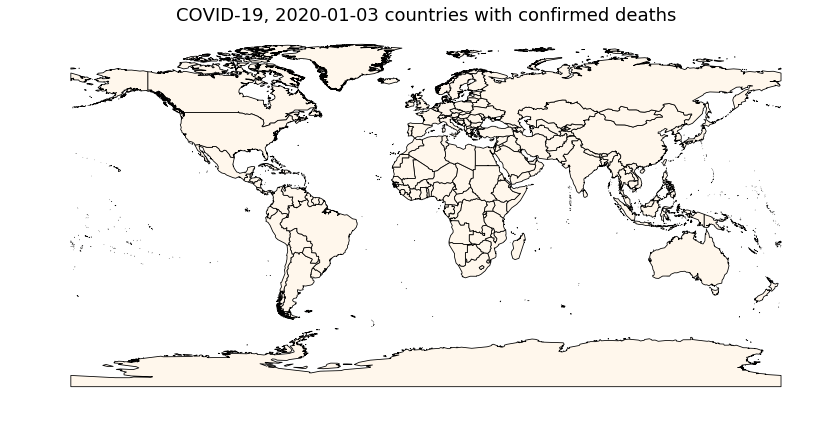

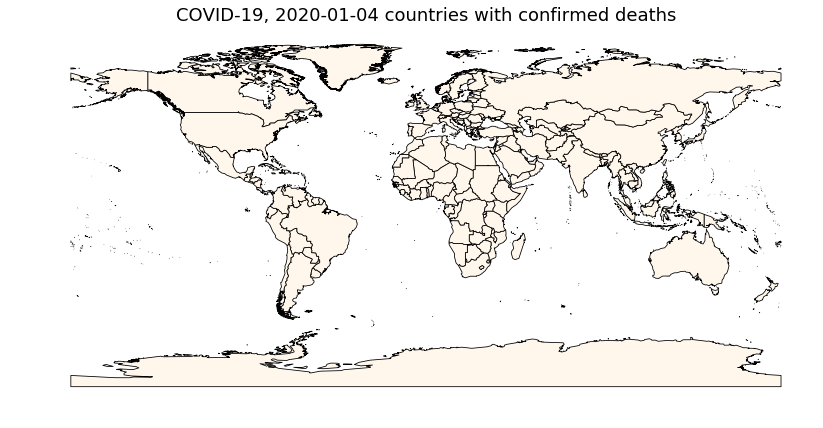

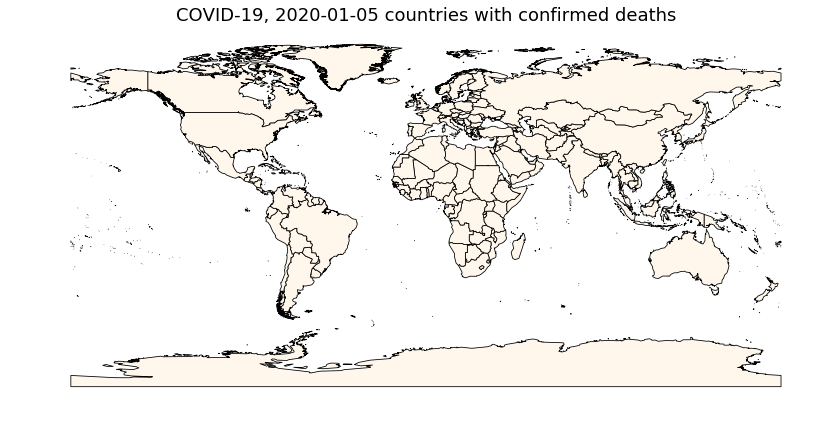

...

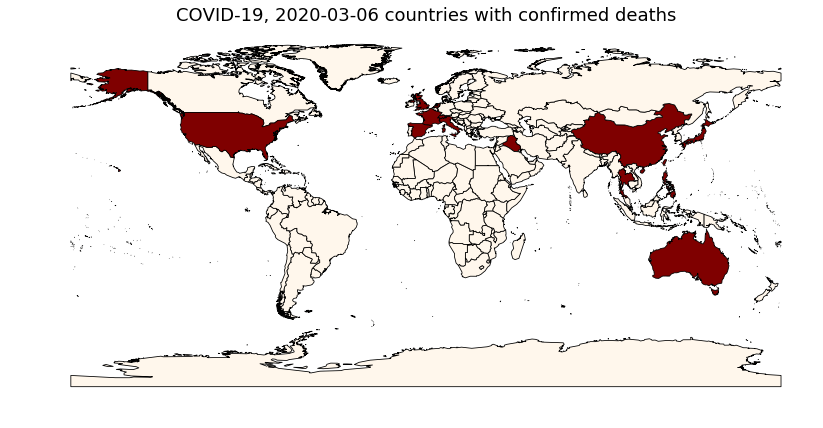

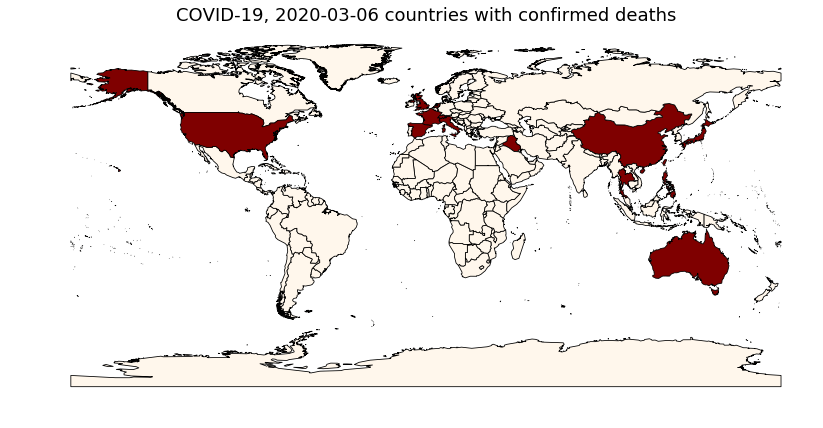

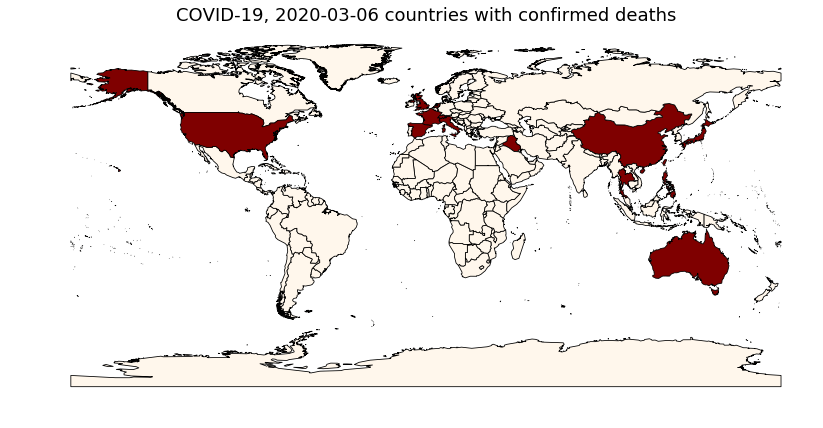

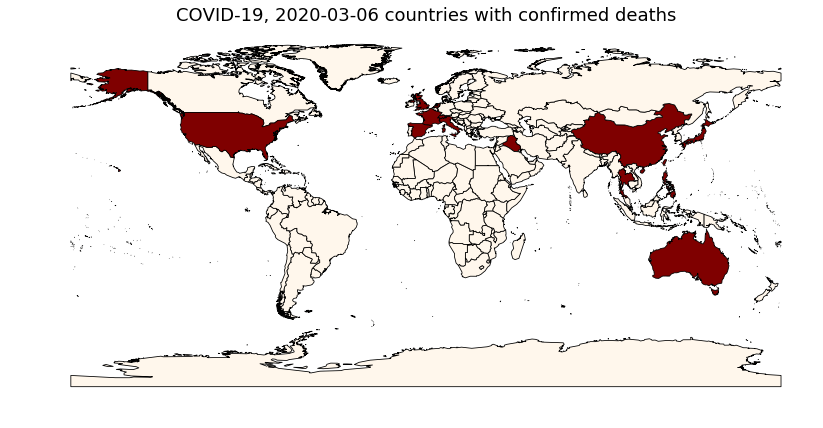

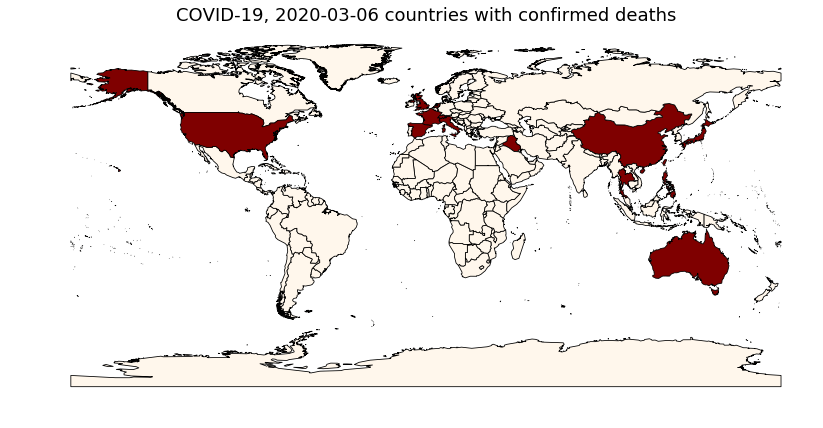

In [0]:
for day in range(0,90):
    data,key = get_dataset(day=day)
    data["isit"] = data[key] > 0
    fig, ax = plt.subplots(1, figsize=(14, 8))
    data.plot(column="isit", cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black', 
              vmin=0, vmax=1)
    
    ax.axis('off')
    ax.set_title('COVID-19, %s countries with confirmed deaths'%key, fontsize=18);
    pl.savefig("COVID-19-%s_countires.png"%key)

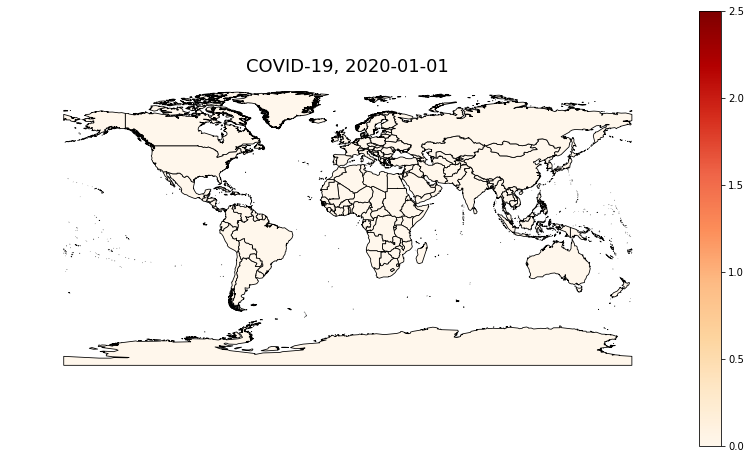

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Traceback (most recent call last):
  File "/Users/fbb/anaconda3/lib/python3.7/site-packages/matplotlib/cbook/__init__.py", line 215, in process
    func(*args, **kwargs)
  File "/Users/fbb/anaconda3/lib/python3.7/site-packages/matplotlib/animation.py", line 999, in _start
    self._init_draw()
  File "/Users/fbb/anaconda3/lib/python3.7/site-packages/matplotlib/animation.py", line 1535, in _init_draw
    for artist in f:
TypeError: 'Figure' object is not iterable


In [0]:
import matplotlib.animation as animation

fig, ax = plt.subplots(1, figsize=(14, 8))
imgs = []
for day in range(0,3):
    data,key = get_dataset(day=day)
    data.plot(column=key, cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black', legend=True, vmin=0, vmax=2.5)
    
    ax.axis('off')
    ax.set_title('COVID-19, %s'%key, fontsize=18);
    pl.show()
    #image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    #image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    imgs.append()

ani = animation.ArtistAnimation(fig, imgs, interval=50, blit=True,
                                repeat_delay=1000)

# ani.save('dynamic_images.mp4')

plt.show()


In [0]:
infected = gpd.GeoDataFrame(pd.read_csv("time_series_19-covid-Confirmed.csv"))

In [0]:
infected["Country/Region"].replace("Mainland China", "China", inplace=True)
infected["Country/Region"].replace("UK", "United Kingdom", inplace=True)
infected["Country/Region"].replace("US", "United States", inplace=True)

In [0]:
for d in infected.columns[4:-6]:
    infected[pd.to_datetime(d).strftime('%Y-%m-%d')] = np.log10(infected[d] + 1)
infected

data, key = get_dataset(day=24, df=infected)
data = gpd.GeoDataFrame(data.groupby("NAME").sum().reset_index(
    ).merge(data[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
            on="NAME", how="left"))#.plot()


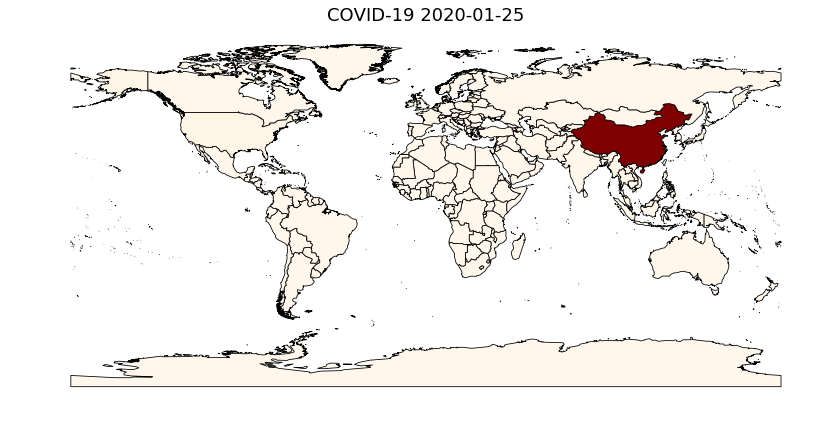

In [0]:
fig, ax = plt.subplots(1, figsize=(14, 8))
data.plot(column=key, 
          clim=(0,100), cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black')
ax.axis('off')
ax.set_title('COVID-19 %s'%key, fontsize=18);

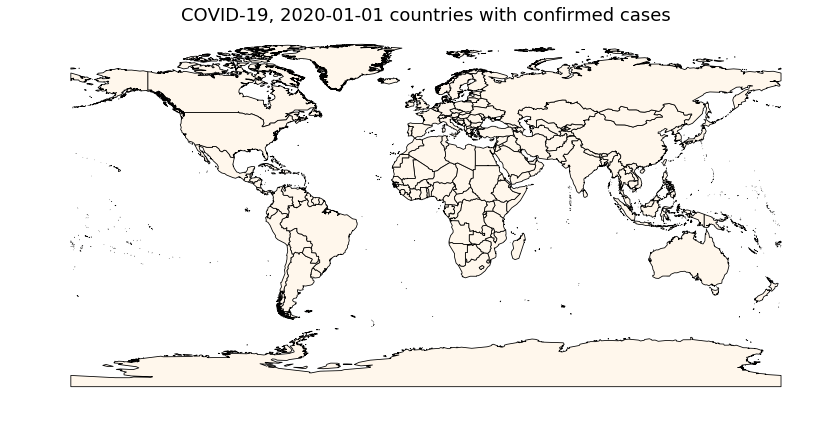

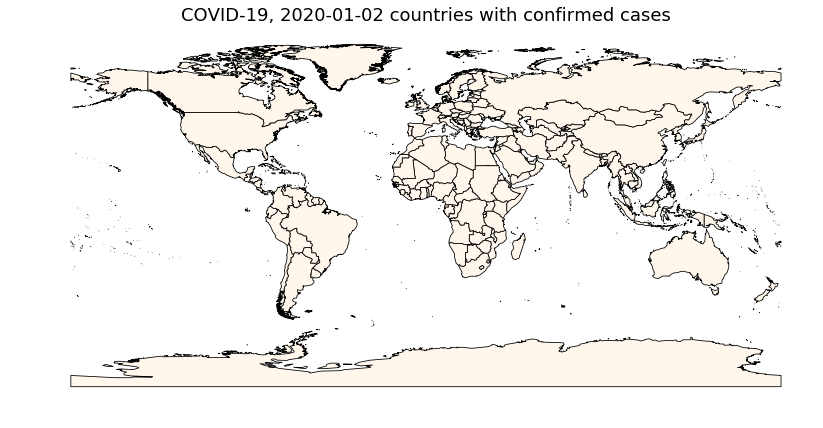

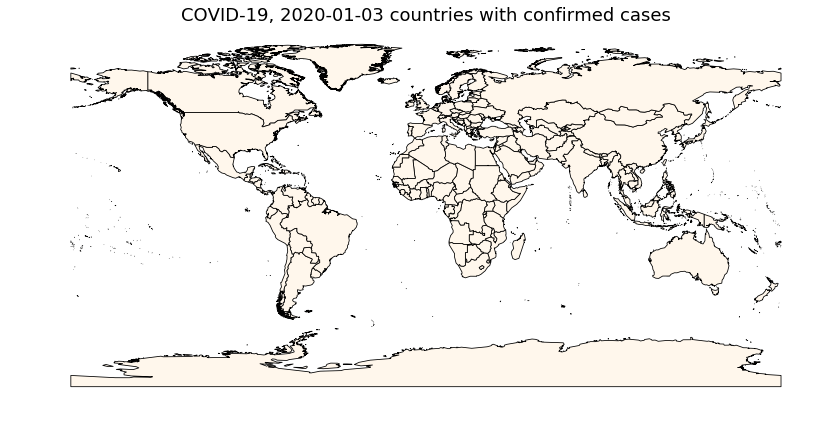

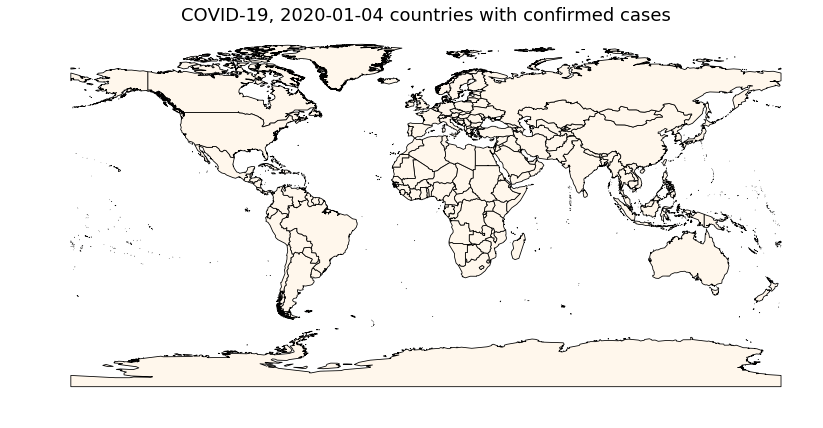

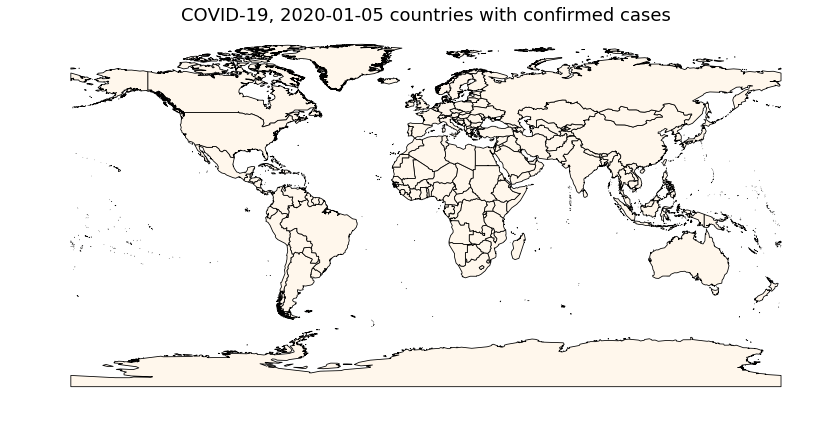

...

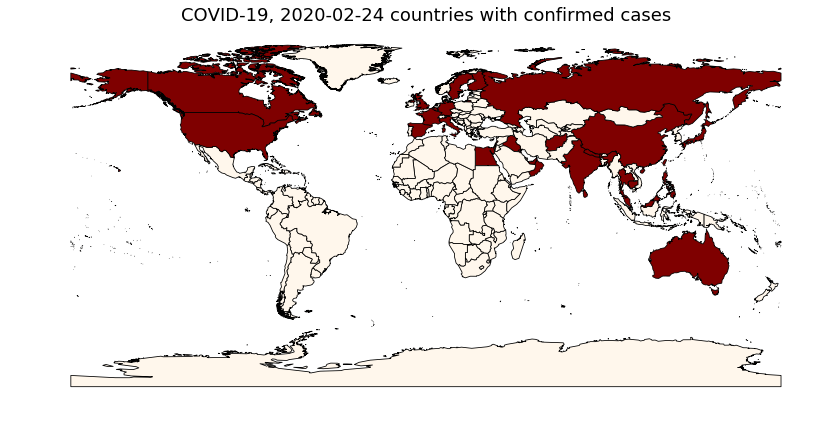

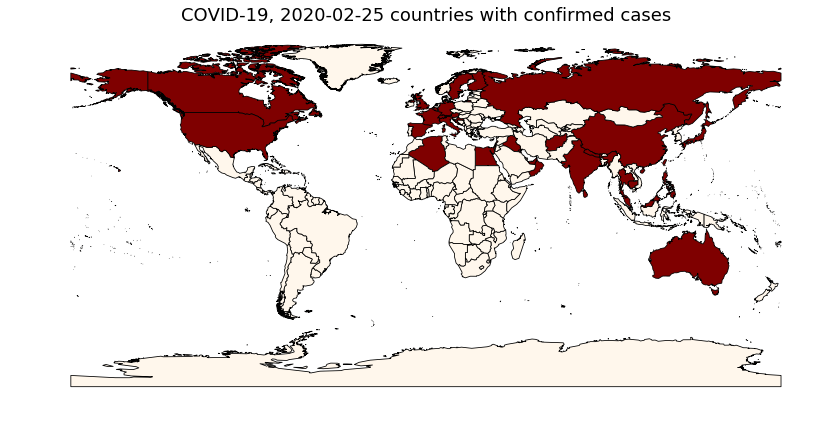

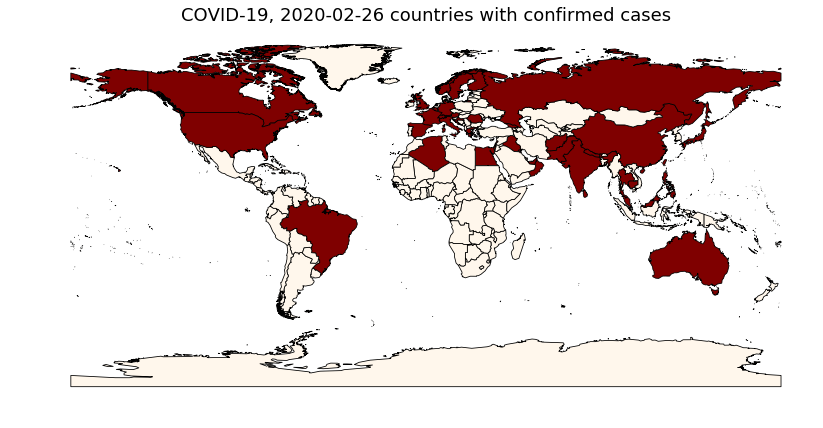

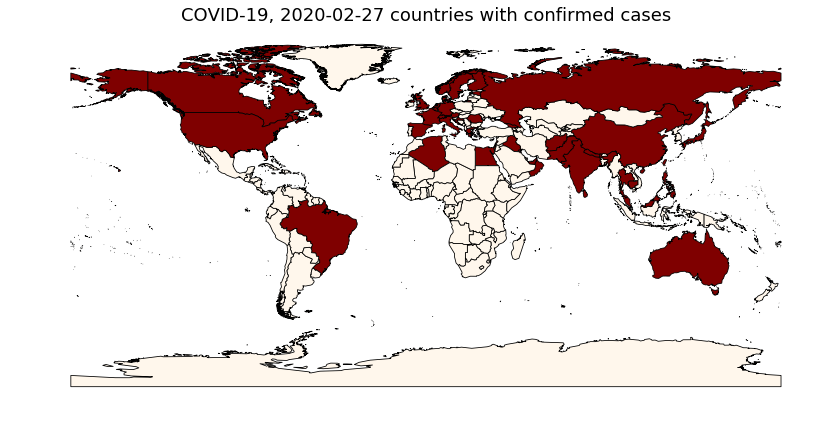

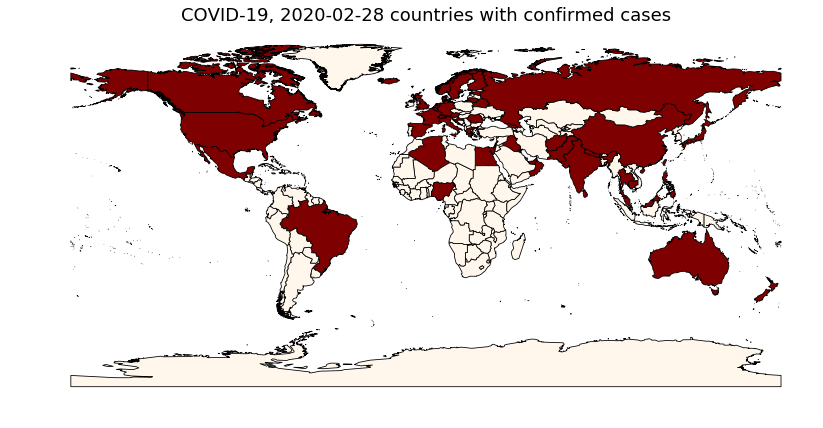

In [0]:
for day in range(0,59):
    data,key = get_dataset(day=day, df=infected)
    data["isit"] = data[key] > 0
    fig, ax = plt.subplots(1, figsize=(14, 8))
    data.plot(column="isit", cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black', 
              vmin=0, vmax=1)
    
    ax.axis('off')
    ax.set_title('COVID-19, %s countries with confirmed cases'%key, fontsize=18);
    pl.savefig("COVID-19-%s_contagion.png"%key)